### Imports and Settings

In [1]:
import mne
import os
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

%matplotlib inline

### Load data

In [2]:
# Specify treatment raw file path
data_path = '/Users/Bella/Desktop/Grosenick_Lab/eeg_patient_data/mdd_dlpfc/'
data_folder = data_path+'subject6_m160_dlpfc_57/m160_dlpfc_day4/'
filename = 'm160_dlpfc_day4_treatment_20230330_010156.mff'
file_raw = os.path.join(data_folder, filename)
raw = mne.io.read_raw_egi(file_raw, preload=True)
raw.info['bads'] = ['VREF']  # try including bads from treatment notes

Reading EGI MFF Header from /Users/Bella/Desktop/Grosenick_Lab/eeg_patient_data/mdd_dlpfc/subject6_m160_dlpfc_57/m160_dlpfc_day4/m160_dlpfc_day4_treatment_20230330_010156.mff...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {} ...
Reading 0 ... 613524  =      0.000 ...   613.524 secs...


#### Plot EOG epochs pre-cleaning

### High-pass filter for drift

First visualize data without any filtering, making sure to disable channel-wise DC shift correction to make slow drifts more obvious.
Estimate the period of visible slow drifts. The applied highpass filter should be higher than the period of slow drifts to ensure they are excluded.

In [3]:
raw.plot(color='darkblue')

Using qt as 2D backend.
Using pyopengl with version 3.1.6


Channels marked as bad:
['VREF']


In [5]:
raw.plot(duration=60, proj=False, n_channels=len(raw.ch_names), remove_dc=False, color='darkblue', scalings='auto')

Using pyopengl with version 3.1.6


Channels marked as bad:
['VREF']


The slow drifts appear to have a period of 2 seconds --> 0.5 Hz
highpass filter should be higher than 0.5 Hz, so 1 Hz highpass seems appropriate
but double check by comparing 0.1 Hz to 1 Hz highpass filtering:

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Filter length: 33001 samples (33.001 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    2.2s


Using matplotlib as 2D backend.


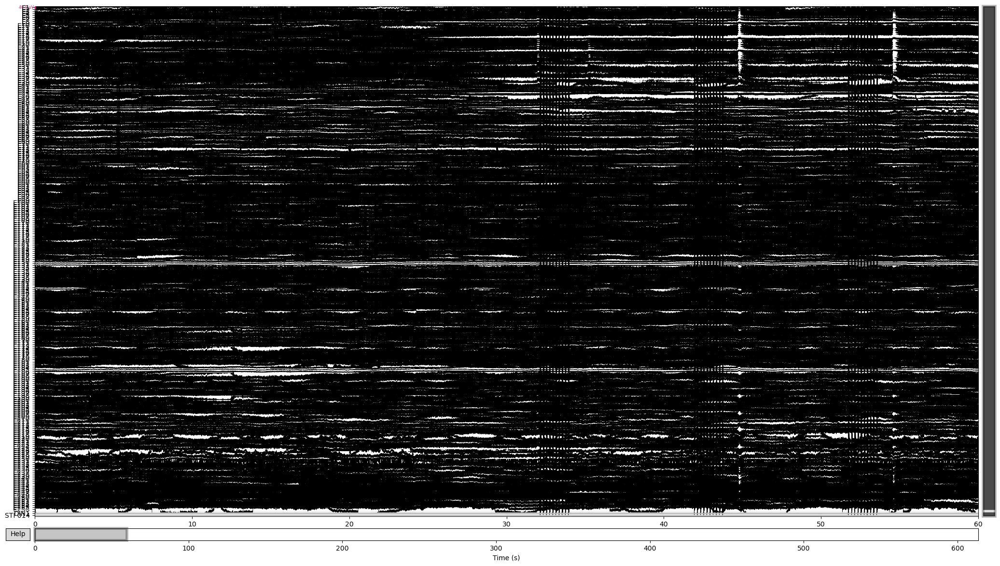

Using qt as 2D backend.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 2.048 (s)


/Users/Bella/mambaforge/envs/klean/lib/python3.11/site-packages/mne/viz/utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 3301 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.8s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    1.7s


Using matplotlib as 2D backend.


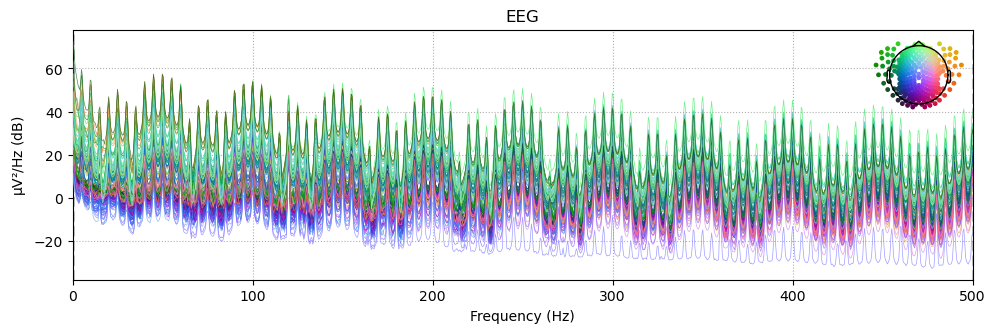

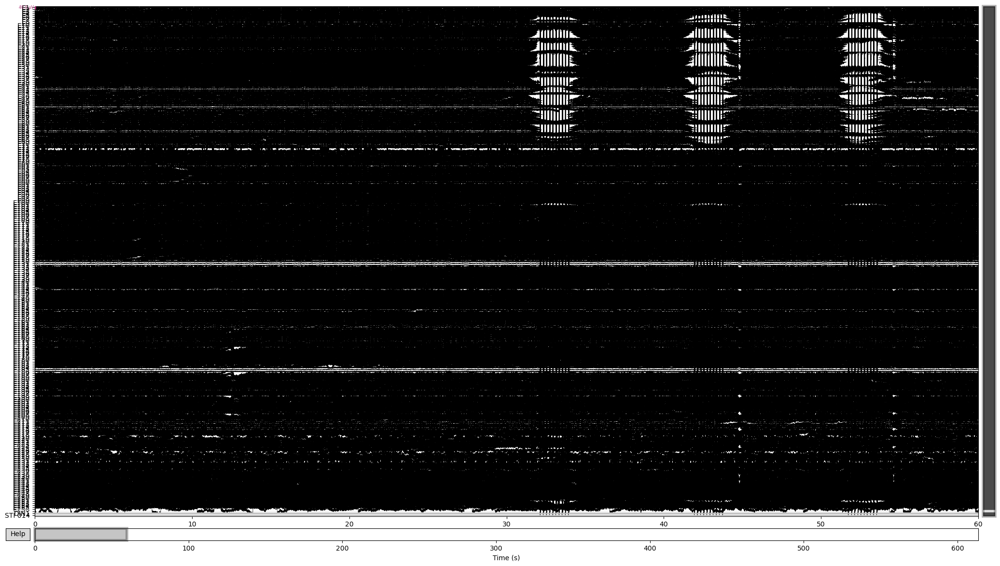

Using qt as 2D backend.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 2.048 (s)


/Users/Bella/mambaforge/envs/klean/lib/python3.11/site-packages/mne/viz/utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


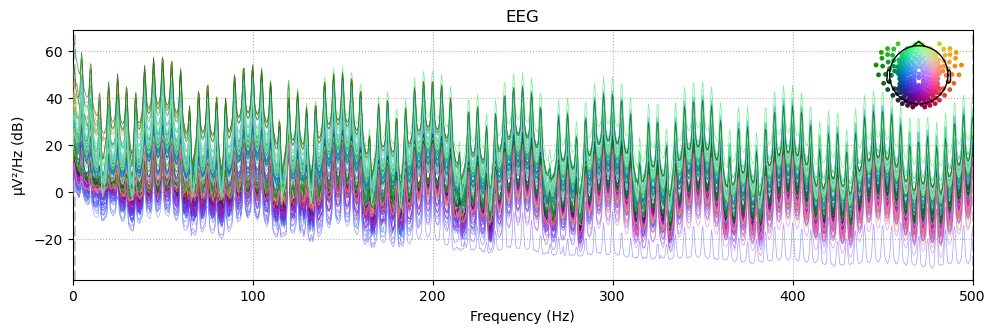

In [6]:
for cutoff in (0.1, 1):
    raw_highpass = raw.copy().filter(l_freq=cutoff, h_freq=None)
    with mne.viz.use_browser_backend("matplotlib"):
        fig = raw_highpass.plot(
            duration=60, proj=False, n_channels=len(raw.ch_names), remove_dc=False)
    fig.subplots_adjust(top=0.9)
    fig.suptitle(f"High-pass filtered at {cutoff} Hz", size="xx-large", weight="bold")
    raw_highpass.plot_psd()

Setting up high-pass filter at 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Filter length: 33001 samples (33.001 s)



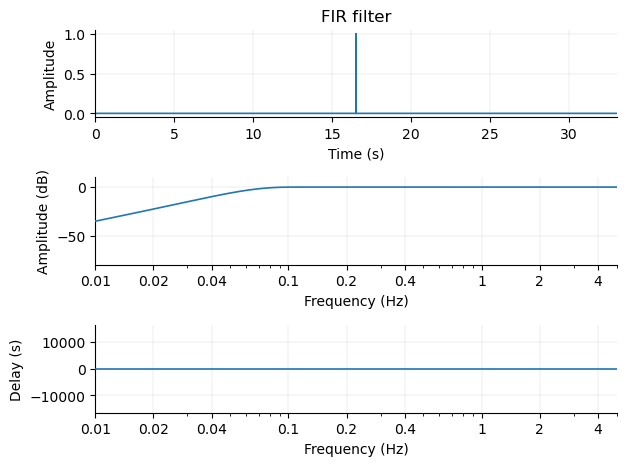

In [4]:
filter_params = mne.filter.create_filter(
    raw.get_data(), raw.info["sfreq"], l_freq=0.1, h_freq=None)

mne.viz.plot_filter(filter_params, raw.info["sfreq"], flim=(0.01, 5)) ;

does the amplitude over frequency plot show the transition point where a filter should be applied to limit noise?

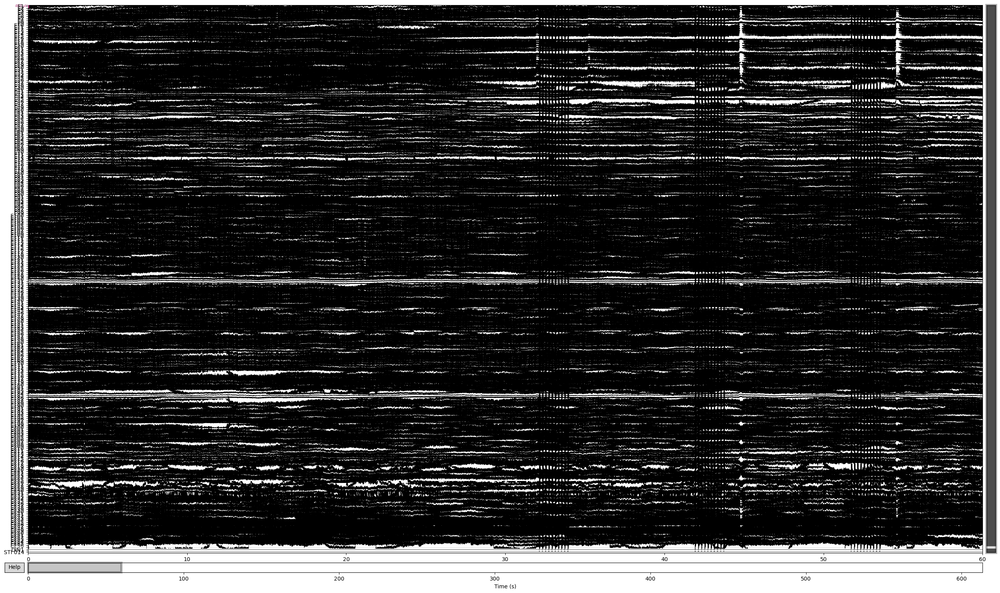

In [6]:
raw_hp = raw.filter(l_freq=0.1, h_freq=None, method='fir', verbose='warning')
raw_hp.plot(duration=60, proj=False, n_channels=len(raw.ch_names), remove_dc=False) ;

### Create epochs

In [7]:
# Read DIN1 events for TMS data
raw_hp.info
events = mne.find_events(raw_hp, stim_channel = 'DIN1')
# Create epochs for full treatment length
epochs = mne.Epochs(raw_hp, events, tmin=-0.1, tmax=0.1, baseline=(0, 0), preload=True)
print(epochs)  # 600 epochs created for Event ID '1'

600 events found
Event IDs: [1]
Not setting metadata
600 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 600 events and 201 original time points ...
0 bad epochs dropped
<Epochs |  600 events (all good), -0.1 – 0.1 s, baseline 0 – 0 s, ~238.6 MB, data loaded,
 '1': 600>


### Tucker decomposition

In [8]:
import tensorly as tl
from tensorly.decomposition import tucker, parafac

epoch_data = epochs.get_data()[:,0:257,:]
epoch_stim = epochs.get_data()[:,257:,:]

import time
tic = time.time()
tucker_decomp = tucker(epoch_data,60)  # What is 60?
#cp_decomp = parafac(epoch_data,60)
print(time.time()-tic)

/Users/Bella/mambaforge/envs/klean/lib/python3.11/site-packages/tensorly/tucker_tensor.py:425: RuntimeWarning: Given only one int for 'rank' for decomposition a tensor of order 3. Using this rank for all modes.
  warnings.warn(message, RuntimeWarning)


17.52555274963379


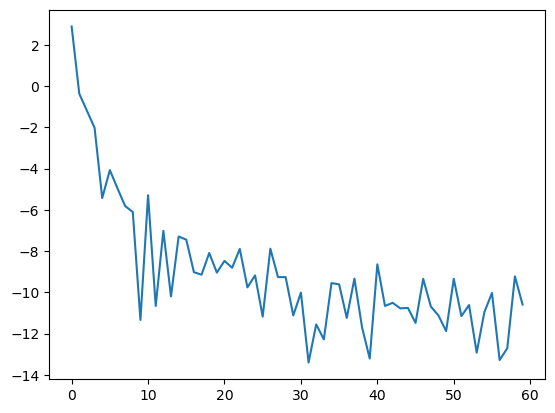

In [9]:
%matplotlib inline
# Plot tensor equivalent of singular values (diagonal of core tensor)
def get_3dtensor_diag(tensor):
    diag = []
    for i in range(tensor.shape[0]):
        diag.append(tensor[i,i,i])
    return np.array(diag)
tucker_diag = get_3dtensor_diag(tucker_decomp.core)
plt.plot(np.log(np.abs(tucker_diag)))

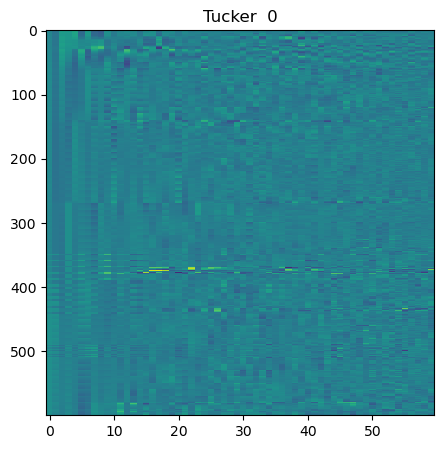

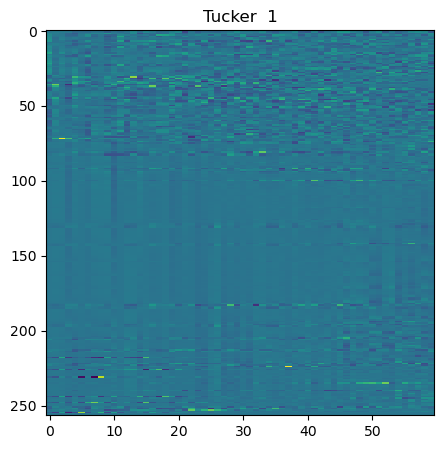

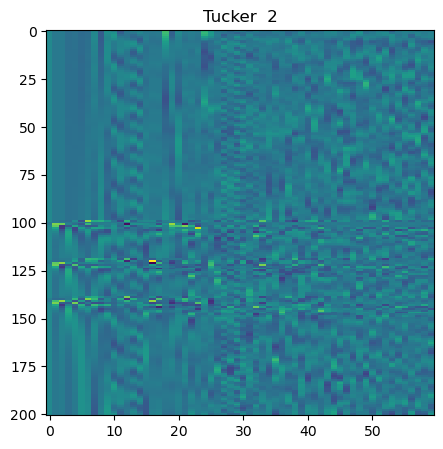

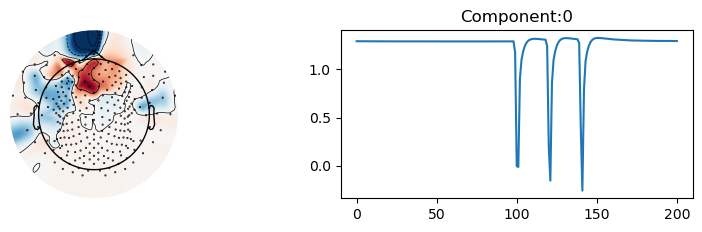

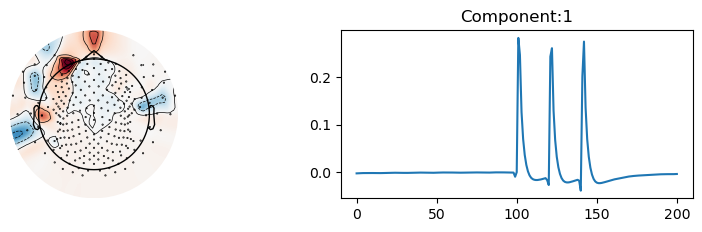

...

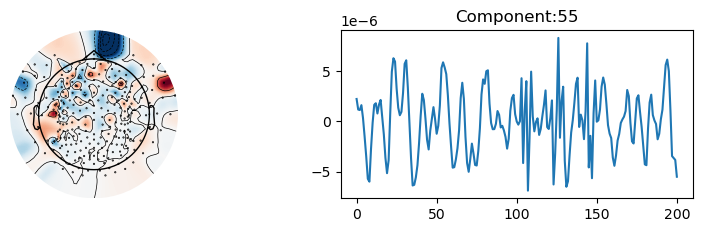

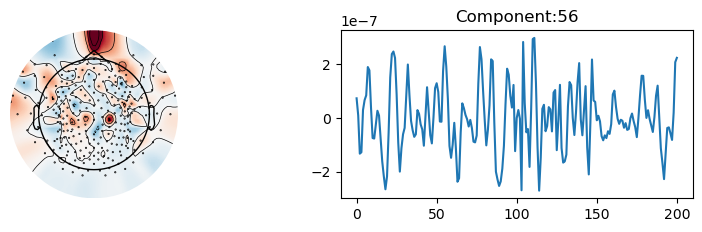

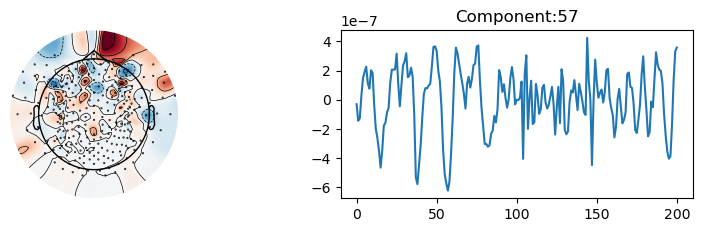

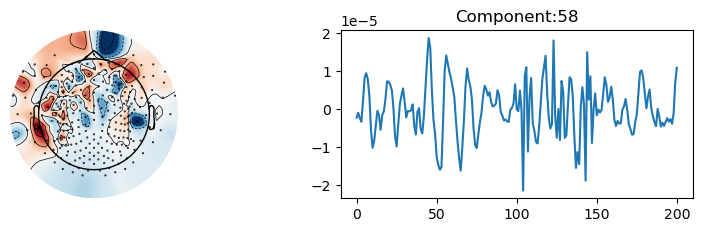

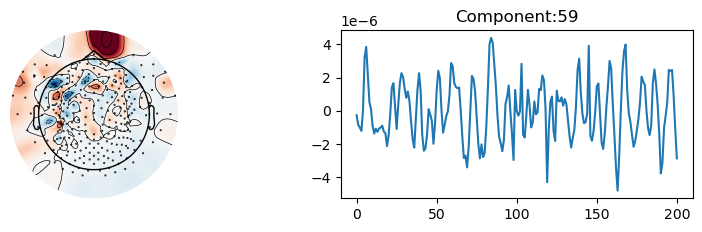

In [11]:
# Plot images of 2D factors
for i in range(3):
    plt.figure(figsize=(5,5))
    plt.imshow(tucker_decomp.factors[i],aspect='auto',interpolation='nearest')
    plt.title("Tucker  "+str(i))

# Plot scalp maps and time series corresponding to tensor decomposition components
for i in range(60):
    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(10,2))
    ax2.plot(tucker_diag[i]*tucker_decomp.factors[2][:,i])
    ax2.set_title("Component:"+str(i))
    mne.viz.plot_topomap(tucker_decomp.factors[1][:,i], pos=raw_hp.info, axes=ax1)

In [12]:
# Zero out first n components to try and remove artifact
tucker_decomp.factors[2][:,0:39] = 0.0

Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated


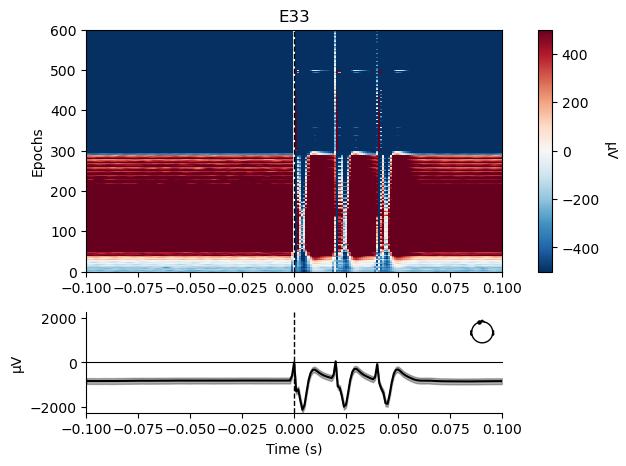

Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated


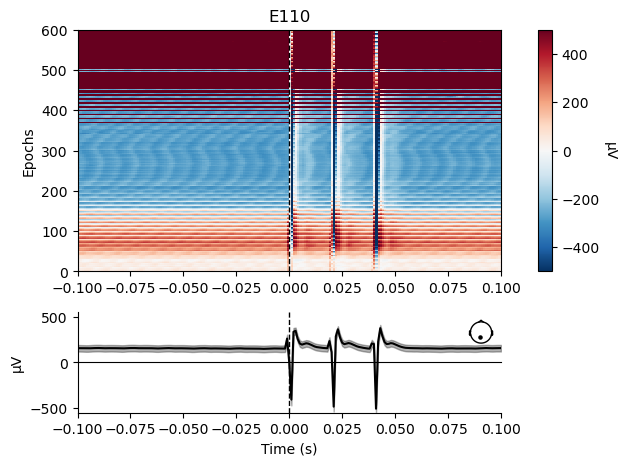

In [16]:
%matplotlib inline
# Plot channel over epochs pre artifact removal
fig = epochs.plot_image(picks=['E33'], vmin=-500, vmax=500)
fig[0].axes[1].set_ylim([-500,500])
fig[0]
fig = epochs.plot_image(picks=['E110'], vmin=-500, vmax=500)
fig[0].axes[1].set_ylim([-500,500])
fig[0] ;

Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated


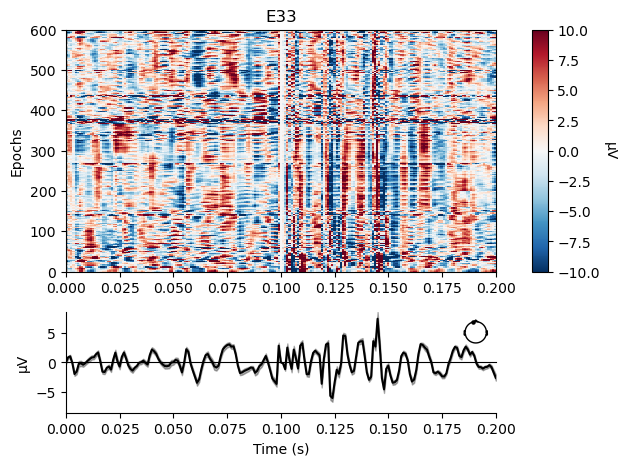

Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated


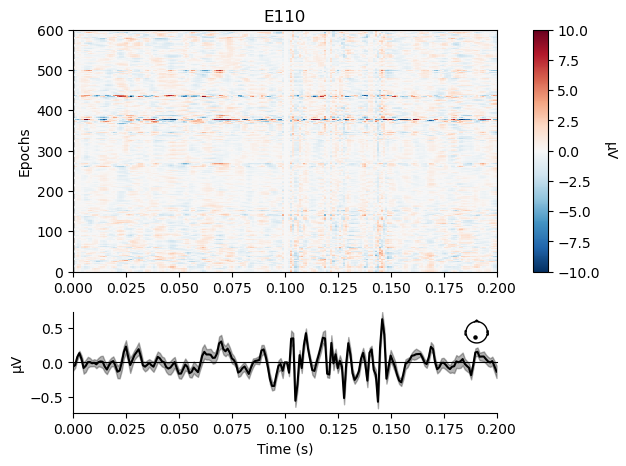

In [18]:
# Plot channel over epochs post artifact removal
tensor_cleaned = tl.tucker_to_tensor(tucker_decomp)
tensor_cleaned = np.concatenate((tensor_cleaned,epoch_stim),axis=1)
epochs_tuckered = mne.EpochsArray(tensor_cleaned,epochs.info)

fig = epochs_tuckered.plot_image(picks=['E33'], vmin= -10, vmax= 10)
fig[0].axes[1].set_ylim([-10,10])
fig[0]
fig = epochs_tuckered.plot_image(picks=['E110'], vmin= -10, vmax= 10)
fig[0].axes[1].set_ylim([-10,10])
fig[0] ; 

#### how to get back to non-epoched data for notch filtering? need to filter epochs_tuckered

Should not glue epochs back together because it causes edge artifacts

<EpochsArray |  600 events (all good), 0 – 0.2 s, baseline off, ~238.6 MB, data loaded,
 '1': 600>


/var/folders/bf/tx13kltn043fzjw05wb4ck0w0000gn/T/ipykernel_38003/1367191966.py:3: FutureWarning: The current default events=None is deprecated and will change to events=True in MNE 1.6. Set events=False to suppress this warning.
  epochs_tuckered.plot() ;


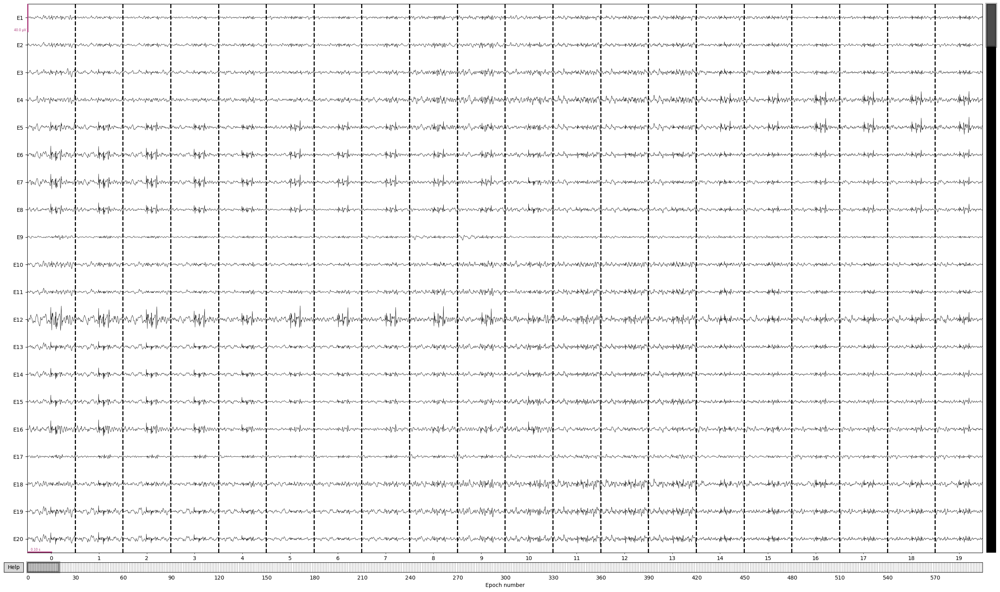

In [20]:
#print(tensor_cleaned)
print(epochs_tuckered)
epochs_tuckered.plot() ;

# Really should not glue epochs back together because it causes edge artifacts
#pseudo_raw_data = np.hstack(epochs_tuckered.get_data())
#pseudo_raw = mne.io.RawArray(pseudo_raw_data, epochs.info)

#print(pseudo_raw)
#pseudo_raw.plot()

In [43]:
# Construct new raw object from epoched data for notch filtering and bad channel rejection
X = np.concatenate(epochs_tuckered.get_data(), axis=1) # new numpy array of appended epochs
raw_tuckered = mne.io.RawArray(X, raw_hp.info)
#treatment_autoreject.set_montage(montage)
#treatment_autoreject.save(data_path+data_fname.split('.')[0]+'_autoreject_raw'+'.fif',overwrite=True)
raw_tuckered.info

Creating RawArray with float64 data, n_channels=259, n_times=120600
    Range : 0 ... 120599 =      0.000 ...   120.599 secs
Ready.


<Info | 10 non-empty values
 bads: []
 ch_names: E1, E2, E3, E4, E5, E6, E7, E8, E9, E10, E11, E12, E13, E14, ...
 chs: 257 EEG, 2 Stimulus
 custom_ref_applied: False
 device_info: 1 item (dict)
 dig: 260 items (3 Cardinal, 257 EEG)
 highpass: 0.1 Hz
 lowpass: 500.0 Hz
 meas_date: 2023-03-20 00:22:09 UTC
 nchan: 259
 projs: []
 sfreq: 1000.0 Hz
 utc_offset: -0400
>

### Notch filter for 60Hz noise

MNE has not added the functionality to notch_filter to work with epochs yet, so notch filter the reconstructed raw_tuckered signal

Filtering raw data in 1 contiguous segment
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 6601 samples (6.601 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.5s


Effective window size : 2.048 (s)
Effective window size : 2.048 (s)


/Users/Bella/mambaforge/envs/klean/lib/python3.11/site-packages/mne/viz/utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)
/Users/Bella/mambaforge/envs/klean/lib/python3.11/site-packages/mne/viz/utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


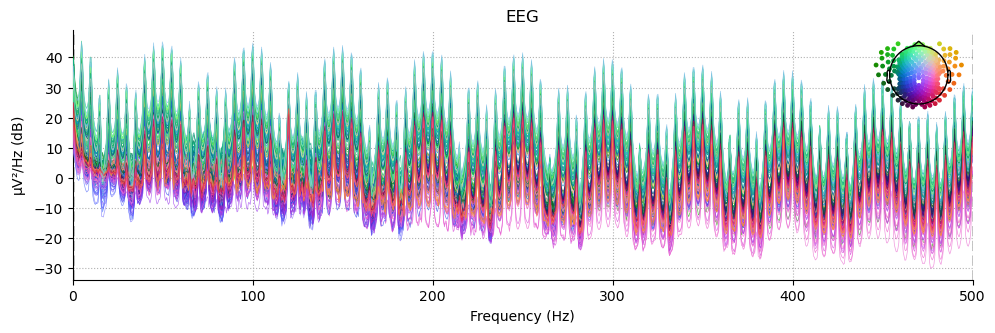

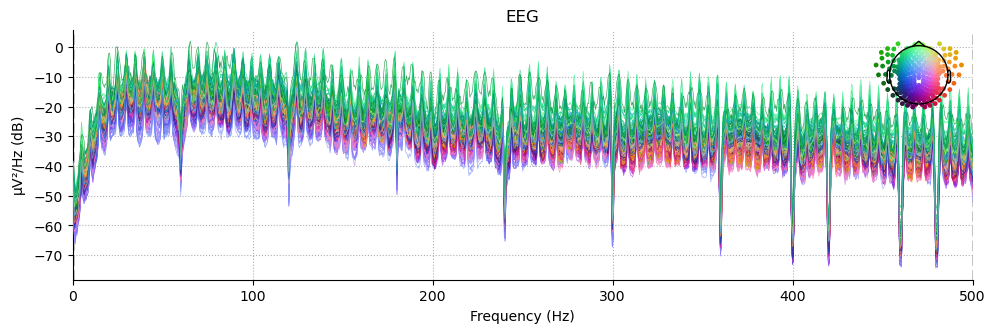

In [44]:
#def notch(epochs_tuckered, notch_freqs, notch_widths):
    #notch_freqs = np.array(notch_freqs)
    #notch_widths = np.asarray(notch_widths)
    #raw_notch = raw.copy().notch_filter(freqs=notch_freqs, notch_widths=notch_widths, verbose='warning')
    #return raw_notch

# Set notch filter at 60Hz and harmonics
notch_freqs = [60,120,180,240,300,360,400,420,460,480]
#notch_widths = [8.0] # This is set pretty wide as there is very significant 60Hz noise in this data

# Notch filter
#epochs_filt = notch(notch_freqs=notch_freqs, notch_widths=notch_widths)
raw_notched = raw_tuckered.copy().notch_filter(freqs=notch_freqs)

# Plot resulting PSDs for raw and filtered data
fig = raw_hp.compute_psd().plot(show=True, exclude='bads')
sns.despine()

fig = raw_notched.compute_psd().plot(show=True, exclude='bads')
sns.despine()

#fig = epochs_notched.compute_psd().plot(show=True, exclude='bads')
#sns.despine()

#### Remove Noisy Channels

Use NoisyChannels to find and remove bad channels.

In [45]:
from pyprep.find_noisy_channels import NoisyChannels

nc = NoisyChannels(raw_notched, random_state=42)
nc.find_all_bads(channel_wise=False)
bad_channels = nc.bad_by_deviation + nc.bad_by_hf_noise + nc.bad_by_dropout + nc.bad_by_ransac + nc.bad_by_correlation

# Print bad channel info
print('  Removed '+str(len(bad_channels))+' total:')
print('  --> Removed '+str(len(nc.bad_by_deviation))+' channels found to be bad by deviation.')
print('  --> Removed '+str(len(nc.bad_by_hf_noise))+' channels found to be bad by high frequency noise.')
print('  --> Removed '+str(len(nc.bad_by_correlation))+' channels found to be bad by correlations.')
print('  --> Removed '+str(len(nc.bad_by_dropout))+' channels found to be bad by dropout.')
print('  --> Removed '+str(len(nc.bad_by_ransac))+' channels found to be bad by RANSAC.')

# Interpolate bad channels
raw_notched.info['bads'].extend(bad_channels)
raw_notched.interpolate_bads(reset_bads=True) # This will clear out data.info['bads']
print("Data shape post interpolation:", raw_notched._data.shape)

# Save out fif of data with bad channel correction
#treatment_filt.save(data_path+data_fname.split('.')[0]+'_noisychannels'+'.fif',overwrite=True)

# removed 31 total and interpolated 28 sensors

# do bad channel rejection on raw.copy and apply bad channels to original raw by inputting theminto bad channels list

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 3301 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.3s


Executing RANSAC
This may take a while, so be patient...


  0%|          |  : 0/24 [00:00<?,       ?it/s]


RANSAC done!
  Removed 31 total:
  --> Removed 4 channels found to be bad by deviation.
  --> Removed 1 channels found to be bad by high frequency noise.
  --> Removed 5 channels found to be bad by correlations.
  --> Removed 0 channels found to be bad by dropout.
  --> Removed 21 channels found to be bad by RANSAC.
Interpolating bad channels
    Automatic origin fit: head of radius 96.5 mm
Computing interpolation matrix from 229 sensor positions
Interpolating 28 sensors
Data shape post interpolation: (259, 120600)


In [52]:
# Create epochs again for bad segment rejection
events = mne.find_events(raw_notched, stim_channel = 'DIN1')
epochs_filt = mne.Epochs(raw_notched, events, tmin=-0.1, tmax=0.1, baseline=(0, 0), preload=True)

600 events found
Event IDs: [1]
Not setting metadata
600 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 600 events and 201 original time points ...
0 bad epochs dropped


#### Reject bad segments

Use autoreject library to reject bad segments. Note this may take some time/memory with longer data sets.

In [53]:
from autoreject import AutoReject, Ransac

def autoreject_bad_segments(epochs, method='autoreject'):
    # Use mne-compatible autoreject library to clean epoched data
    n_interpolates = np.array([1, 4, 32])
    consensus_percs = np.linspace(0, 1.0, 11)

    if method=='autoreject':
        ar = AutoReject(n_interpolates, consensus_percs, thresh_method='bayesian_optimization', random_state=42)
    elif method=='ransac':
        ar = Ransac()
    else:
        raise pipeline_log.ValueError("Specified bad segment method not implemented. Current options are 'autoreject' and 'ransac'.")
    epochs = ar.fit_transform(epochs)
    return epochs, ar

epochs_filt, ar = autoreject_bad_segments(epochs_tuckered, method='autoreject')

# dropped 189 epochs

Running autoreject on ch_type=eeg


  0%|          | Creating augmented epochs : 0/257 [00:00<?,       ?it/s]

  0%|          | Computing thresholds ... : 0/257 [00:00<?,       ?it/s]

  0%|          | Repairing epochs : 0/600 [00:00<?,       ?it/s]

  0%|          | n_interp : 0/3 [00:00<?,       ?it/s]

  0%|          | Repairing epochs : 0/600 [00:00<?,       ?it/s]

  0%|          | Fold : 0/10 [00:00<?,       ?it/s]

  0%|          | Repairing epochs : 0/600 [00:00<?,       ?it/s]

  0%|          | Fold : 0/10 [00:00<?,       ?it/s]

  0%|          | Repairing epochs : 0/600 [00:00<?,       ?it/s]

  0%|          | Fold : 0/10 [00:00<?,       ?it/s]





Estimated consensus=0.10 and n_interpolate=4


  0%|          | Repairing epochs : 0/600 [00:00<?,       ?it/s]

Dropped 189 epochs: 0, 1, 10, 11, 12, 13, 20, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 44, 45, 46, 47, 48, 49, 50, 51, 56, 57, 58, 59, 60, 61, 63, 66, 67, 68, 70, 71, 72, 74, 75, 76, 77, 78, 90, 104, 105, 111, 112, 120, 123, 131, 139, 140, 141, 142, 143, 149, 152, 233, 238, 260, 261, 263, 265, 266, 267, 268, 269, 340, 341, 343, 344, 345, 349, 359, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 396, 398, 404, 405, 407, 408, 415, 419, 420, 423, 425, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 445, 448, 449, 450, 451, 452, 460, 461, 470, 472, 473, 479, 480, 481, 488, 490, 491, 494, 496, 497, 498, 499, 500, 503, 505, 508, 509, 510, 515, 520, 521, 530, 533, 540, 560, 563, 570, 575, 576, 577, 578, 579, 580, 581, 582, 583, 584, 587, 588, 589, 590, 592, 593, 594, 598, 599


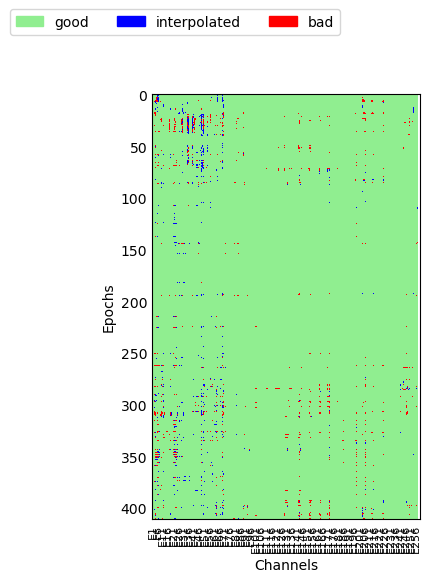

In [55]:
# Generate rejected segment plot
ar.get_reject_log(epochs_filt).plot(show=True) ;


/var/folders/bf/tx13kltn043fzjw05wb4ck0w0000gn/T/ipykernel_38003/4193120335.py:1: FutureWarning: The current default events=None is deprecated and will change to events=True in MNE 1.6. Set events=False to suppress this warning.
  epochs_filt.plot() ;


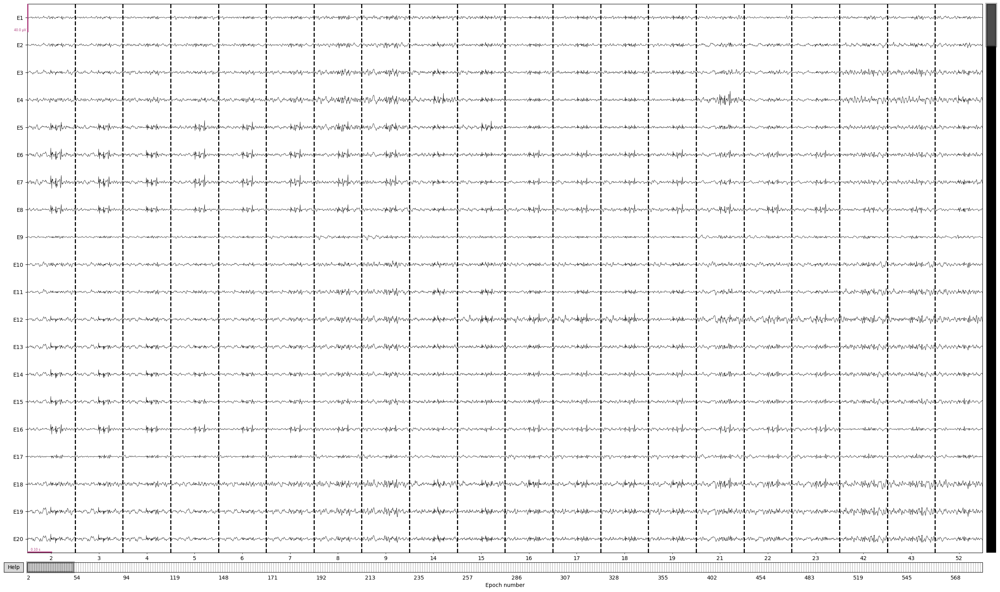

<Info | 10 non-empty values
 bads: []
 ch_names: E1, E2, E3, E4, E5, E6, E7, E8, E9, E10, E11, E12, E13, E14, ...
 chs: 257 EEG, 2 Stimulus
 custom_ref_applied: False
 device_info: 1 item (dict)
 dig: 260 items (3 Cardinal, 257 EEG)
 highpass: 0.1 Hz
 lowpass: 500.0 Hz
 meas_date: 2023-03-20 00:22:09 UTC
 nchan: 259
 projs: []
 sfreq: 1000.0 Hz
 utc_offset: -0400
>

In [56]:
epochs_filt.plot() ;
epochs_filt.info

Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated


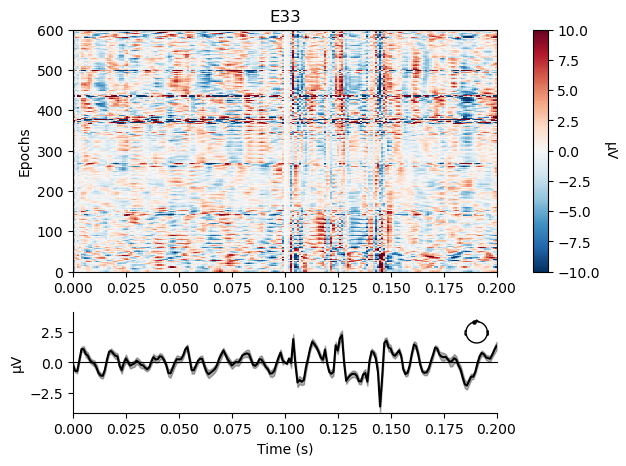

Not setting metadata
411 matching events found
No baseline correction applied
0 projection items activated


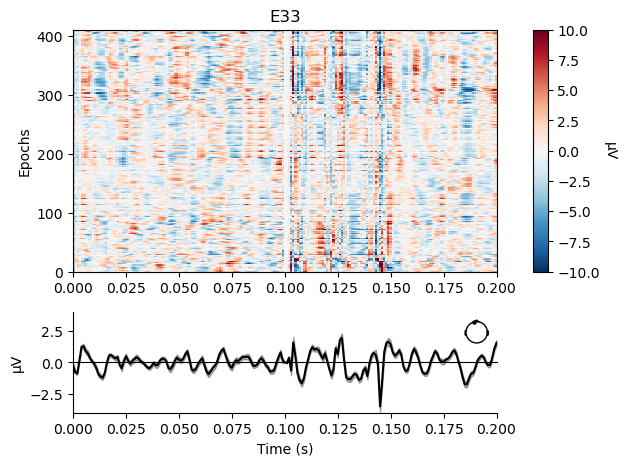

In [57]:
# Plot signal over epochs and time before bad segment rejection
fig = epochs_tuckered.plot_image(picks=['E33'], vmin= -10, vmax= 10)
fig[0].axes[1].set_ylim([-10,10])
fig[0] 

# Plot after notch filter, bad channel, and bad segment rejection
fig = epochs_filt.plot_image(picks=['E33'], vmin= -10, vmax= 10)
fig[0].axes[1].set_ylim([-10,10])
fig[0] ;

#### Replot EOG epochs after bad channel and segment rejection

Using EOG channels: E32, E241, E25, E238
EOG channel index for this subject is: [ 24  31 237 240]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 2000 samples (10.000 s)

Now detecting blinks and generating corresponding events
Found 2 significant peaks
Number of EOG events detected: 2
Not setting metadata
2 matching events found
Applying baseline correction (mode: mean)
Using data from preloaded Raw for 2 events and 201 original time points ...
0 bad epochs dropped
Not setting metadata
2 matching event

/var/folders/q8/v05ct80136s_vt_x7bq2dq780000gn/T/ipykernel_12250/2680552442.py:1: FutureWarning: The default for pick_channels will change from ordered=False to ordered=True in 1.5 and this will result in a change of behavior because the resulting channel order will not match. Either use a channel order that matches your instance or pass ordered=False.
  eog_epochs = mne.preprocessing.create_eog_epochs(treatment_autoreject, baseline=(-0.5, -0.2), ch_name=['E32','E241','E25','E238'])


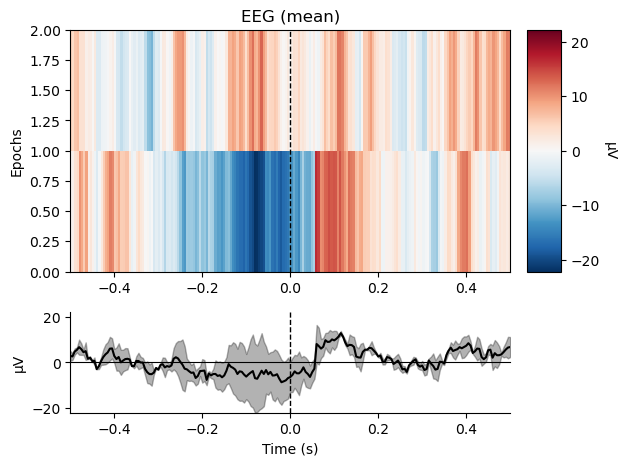

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No projector specified for this dataset. Please consider the method self.add_proj.
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


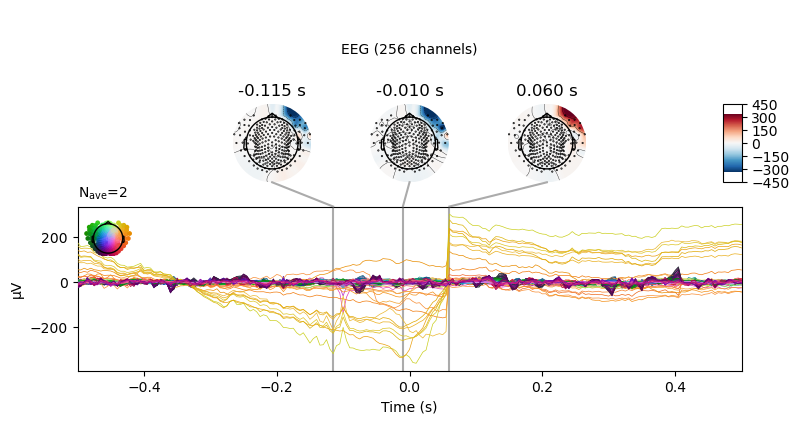

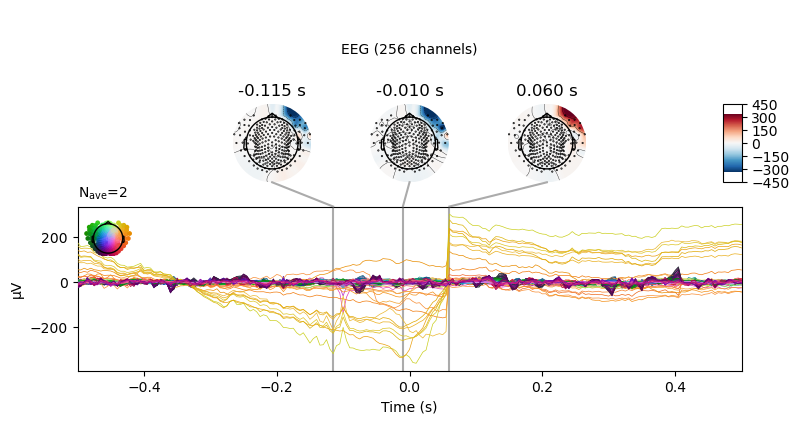

In [11]:
eog_epochs = mne.preprocessing.create_eog_epochs(treatment_autoreject, baseline=(-0.5, -0.2), ch_name=['E32','E241','E25','E238'])
eog_epochs.plot_image(combine="mean")
eog_epochs.average().plot_joint()

For reloading saved clean data if jupyter notebook barfs

In [12]:
#treatment_autoreject = mne.io.Raw(data_path+data_fname.split('.')[0]+'_autoreject_raw'+'.fif', preload=True )


### Replot Epochs over time after notch filtering and bad channel + bad segment rejection

In [ ]:
fig = epochs_cleaned.plot_image(picks=['E33'], vmin= -10, vmax= 10)
fig[0].axes[1].set_ylim([-10,10])
fig[0]

### Run ICA on cleaned data

Try using FastICA vs Picard

In [13]:
import os
import mne
from mne.preprocessing import ICA, corrmap, create_ecg_epochs, create_eog_epochs
treatment_autoreject = treatment_autoreject.copy().filter(l_freq=1.0, h_freq=None)

ica = ICA(n_components=200, max_iter="auto", random_state=97)
ica.fit(treatment_autoreject)

explained_var_ratio = ica.get_explained_variance_ratio(treatment_autoreject)
for channel_type, ratio in explained_var_ratio.items():
    print(
        f"Fraction of {channel_type} variance explained by all components: " f"{ratio}"
    )

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 661 samples (3.305 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    1.1s


Fitting ICA to data using 256 channels (please be patient, this may take a while)
Selecting by number: 200 components
Fitting ICA took 147.4s.
Fraction of eeg variance explained by all components: 0.9925741806737702


Plot ICA spatial sources

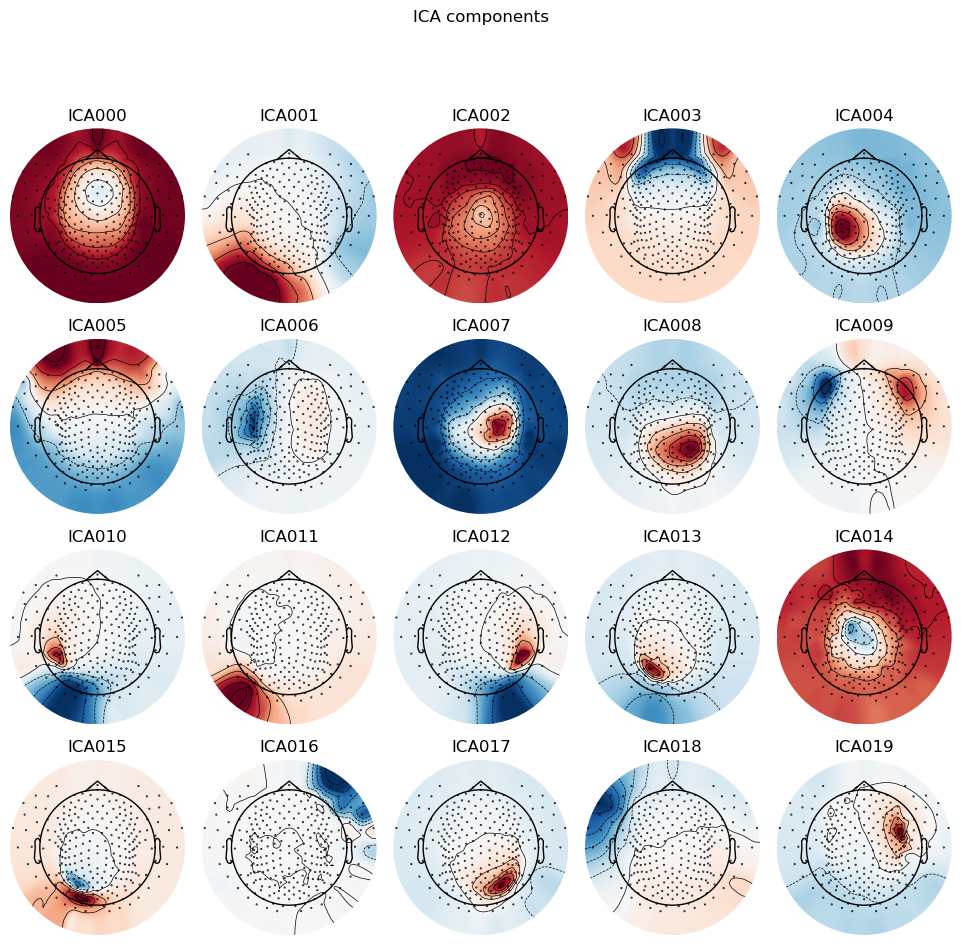

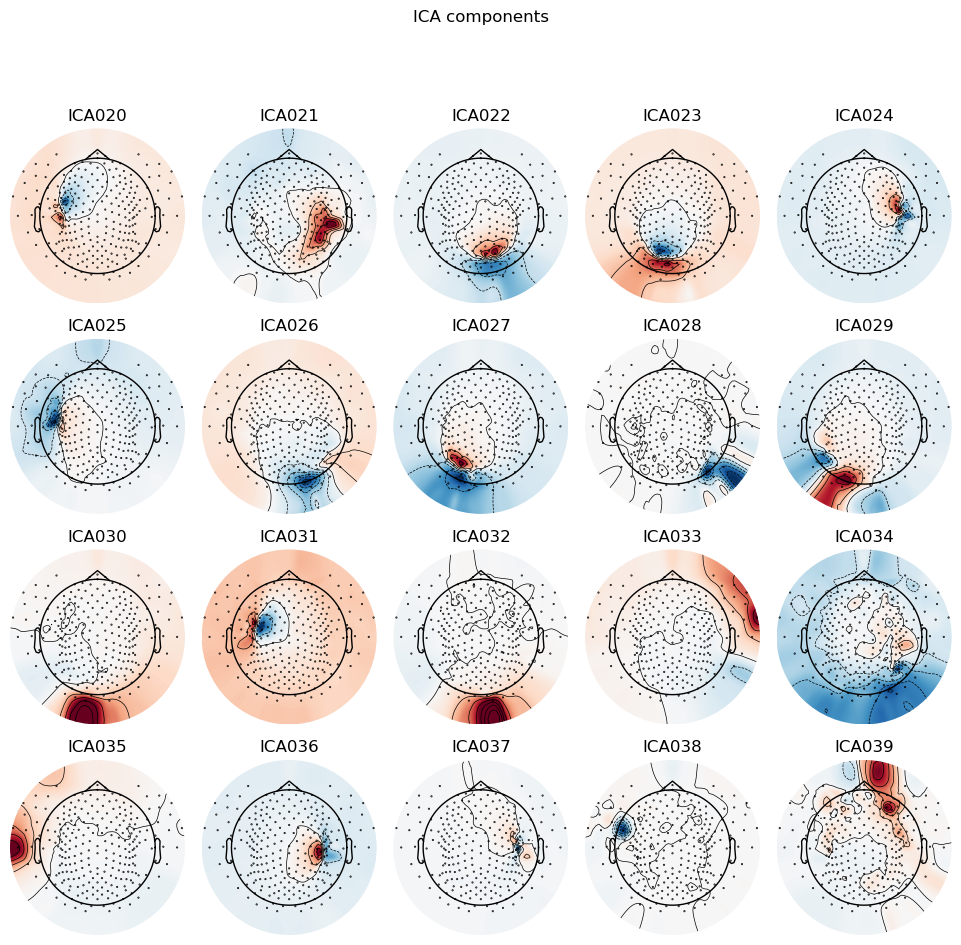

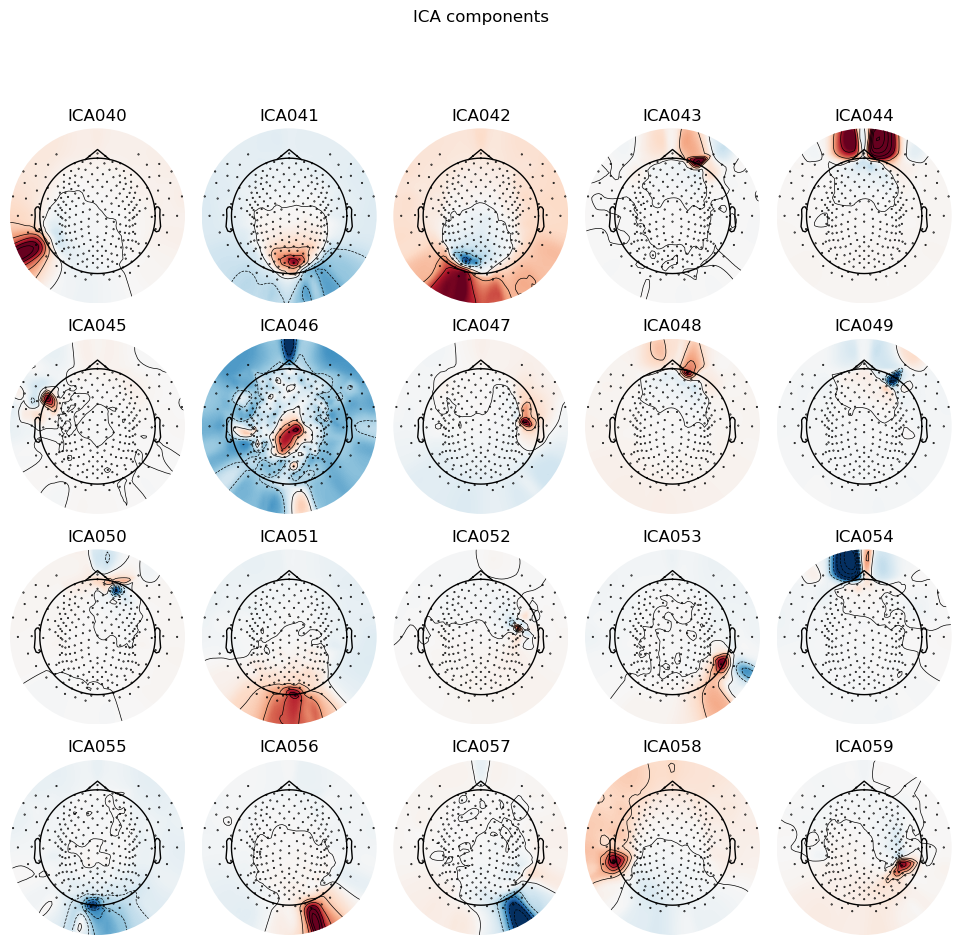

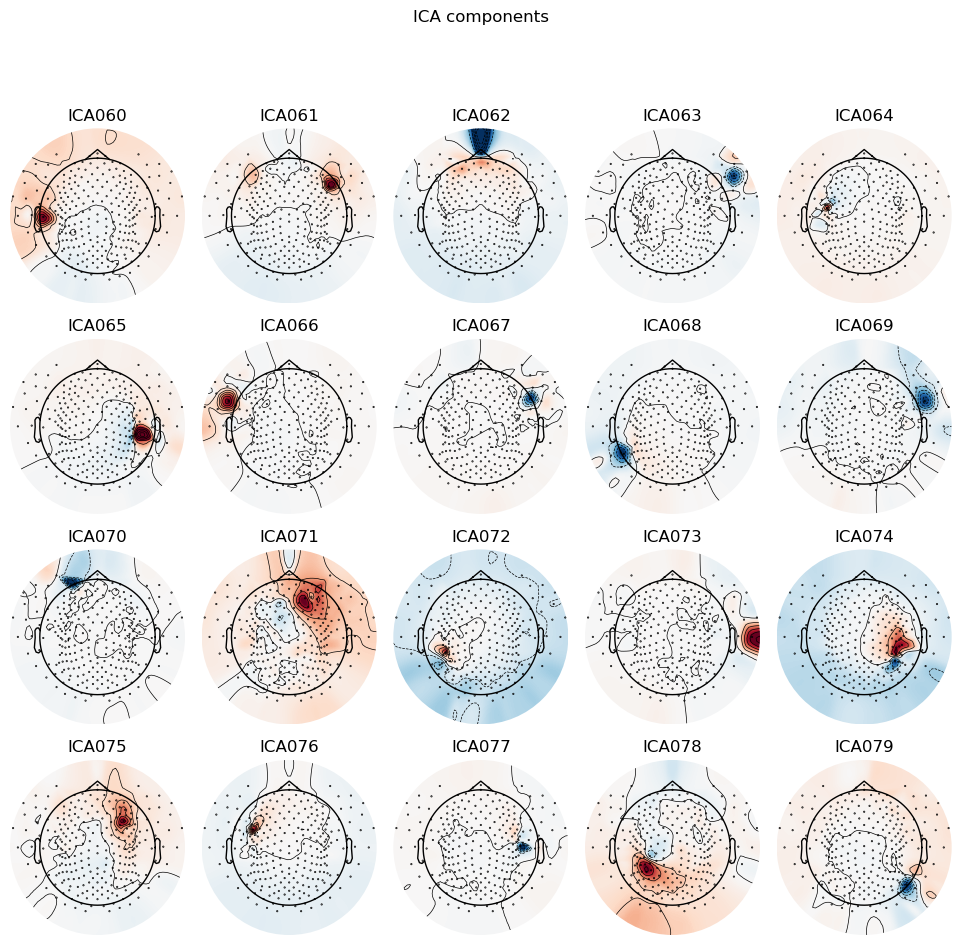

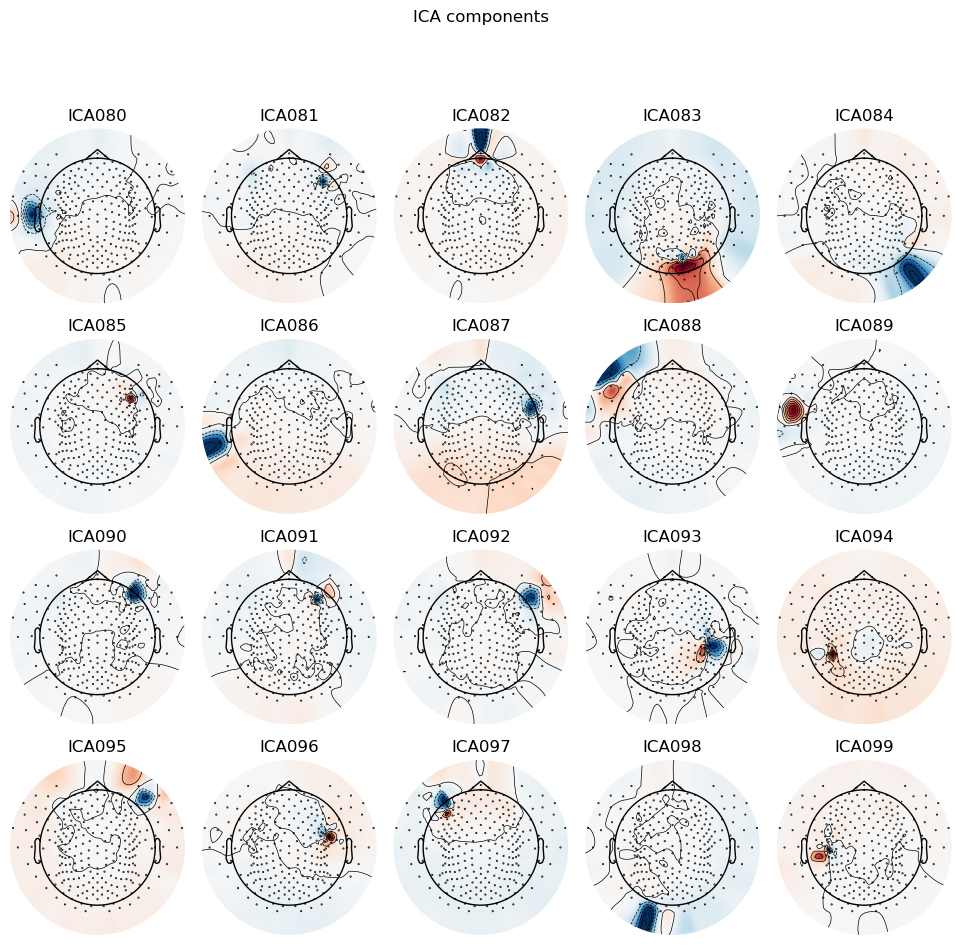

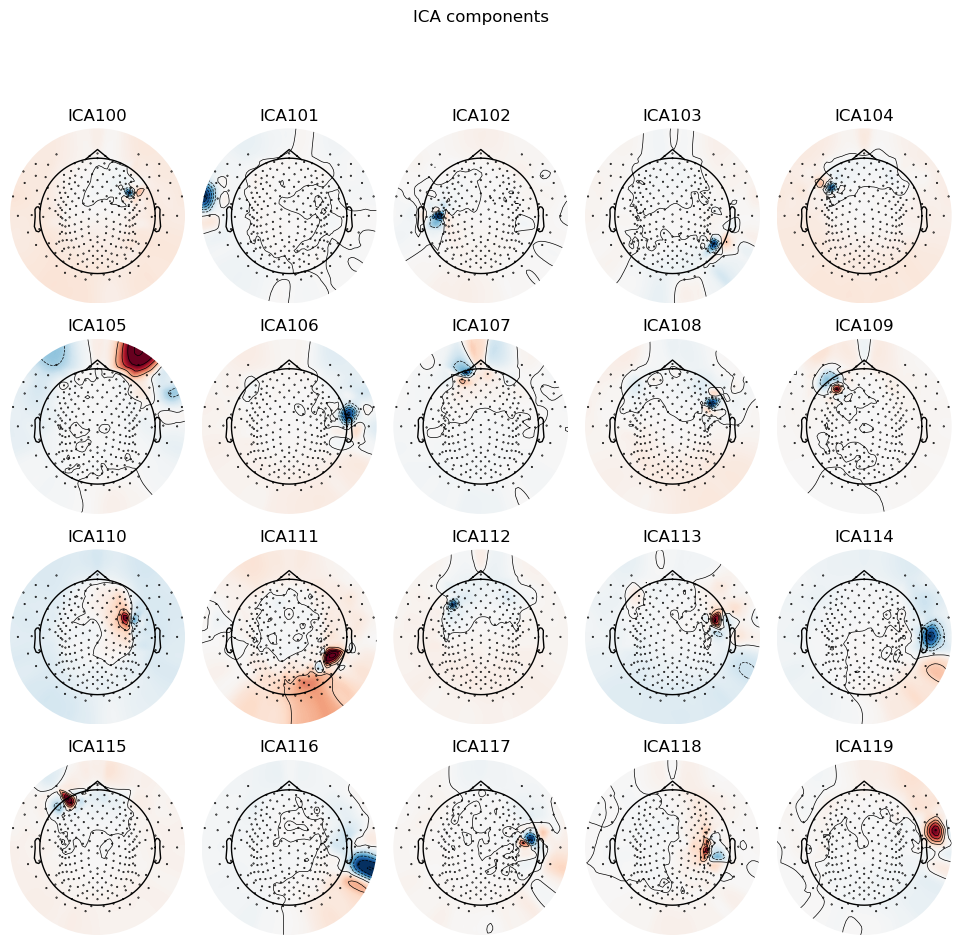

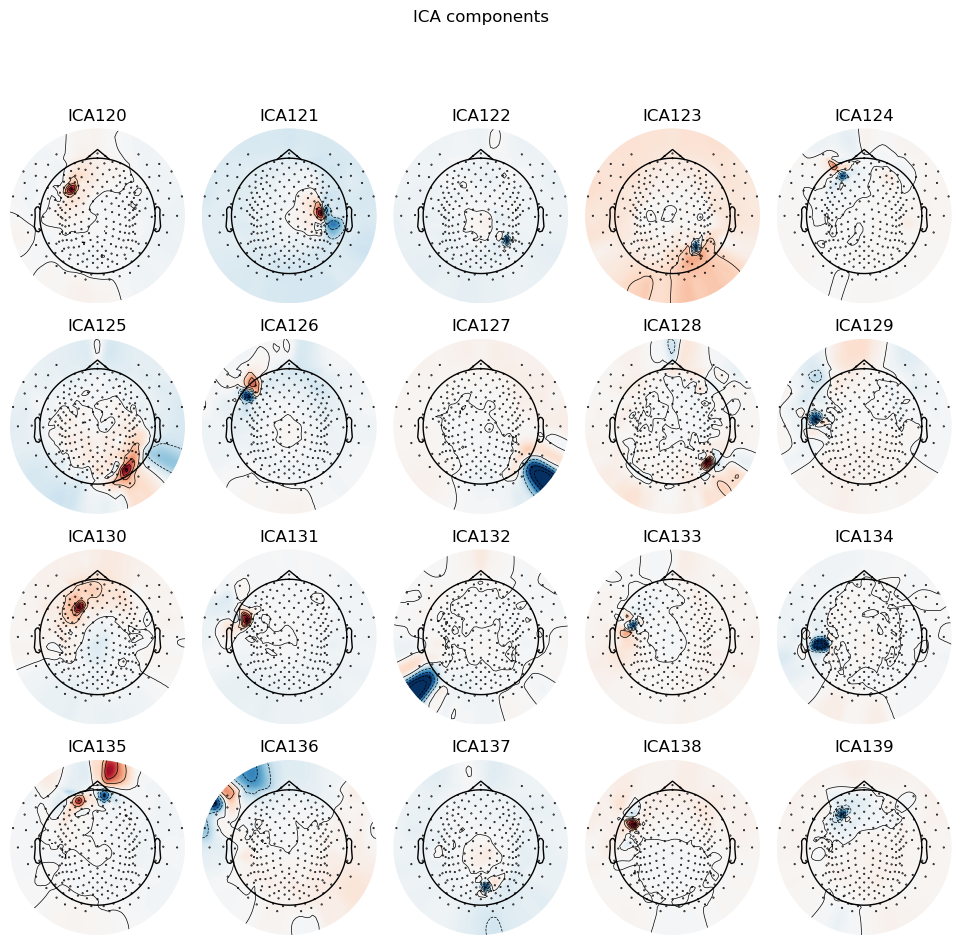

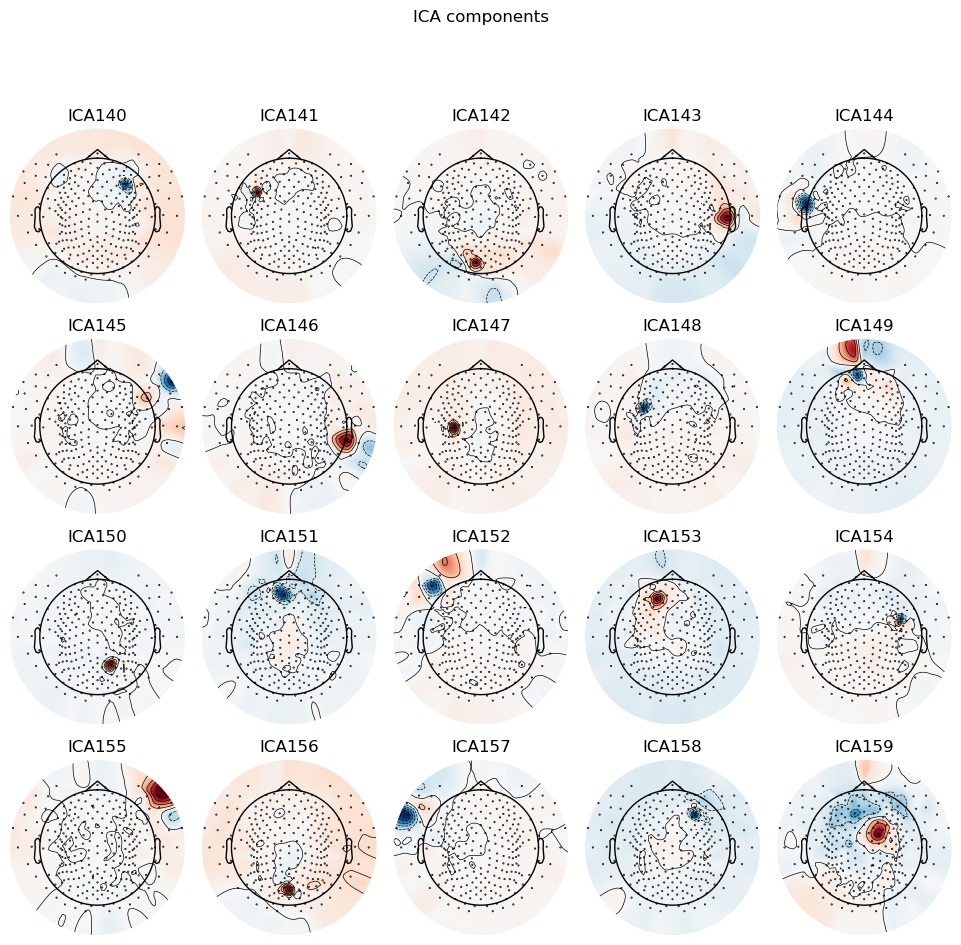

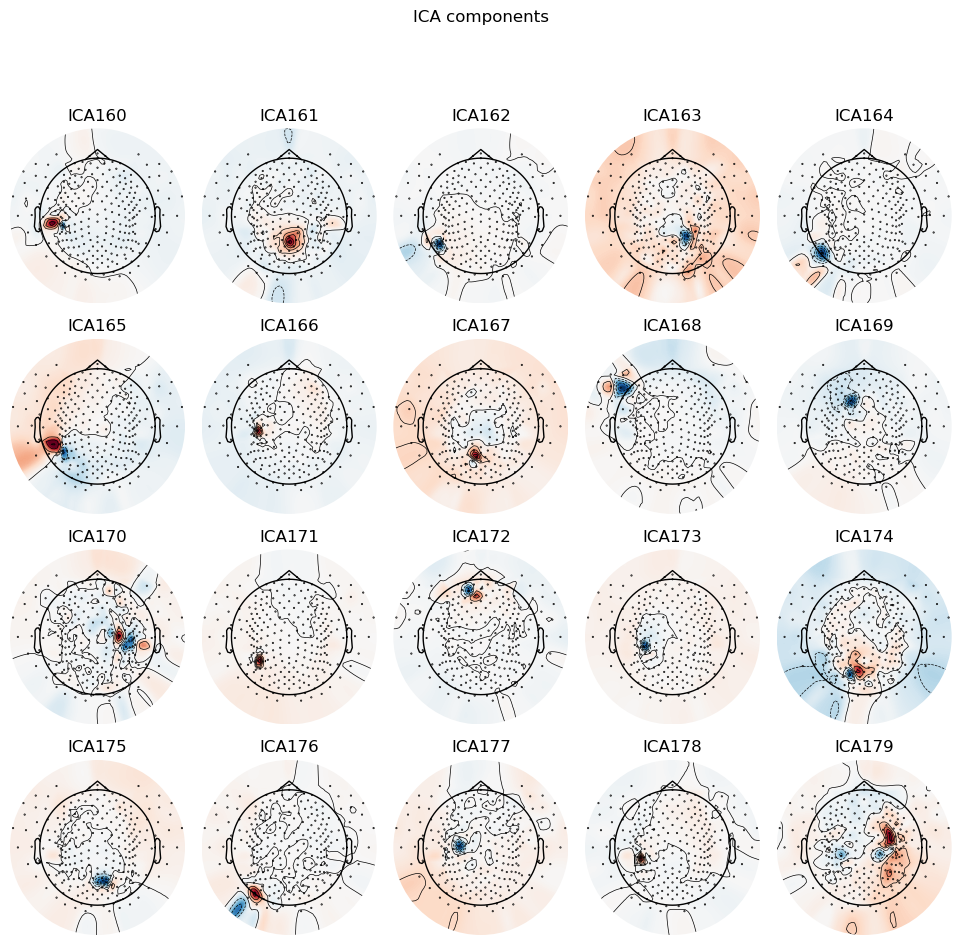

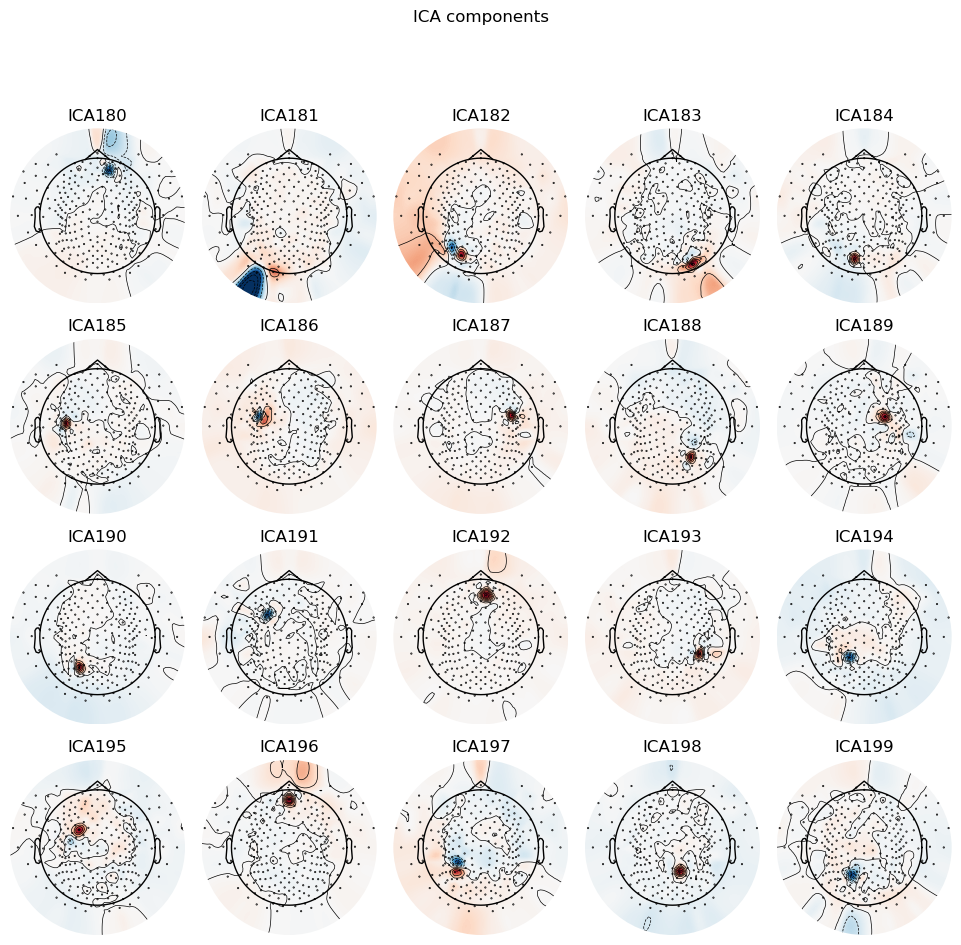

[<MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>]

In [14]:
ica.plot_components()


Plot ICA source traces

In [13]:
ica.plot_sources(treatment_autoreject, show_scrollbars=False)


Creating RawArray with float64 data, n_channels=200, n_times=620600
    Range : 0 ... 620599 =      0.000 ...  3102.995 secs
Ready.
Using qt as 2D backend.
Using pyopengl with version 3.1.6


Plot cleaned data traces

In [15]:
treatment_autoreject.plot()

Using pyopengl with version 3.1.6


Channels marked as bad:
none


In [ ]:
# Remove bad channels, reconstruct and run through autoreject again?

In [20]:
from mne_icalabel import label_components

# Filter data to icalabel requirements
mne_filt = treatment_autoreject.filter(l_freq=1.0, h_freq=99.0, verbose='warning')

# Use label_components function from ICLabel library to classify ICs and get their estimated probabilities
print('  Using ICALabel to classify independent components.')
ic_labels = label_components(mne_filt, ica, method="iclabel")
labels = ic_labels["labels"]
    
# Exclude ICs not in 'keep' list and reconstruct cleaned raw data
keep=['brain']
exclude_idx = [idx for idx, label in enumerate(labels) if label not in keep]
print(f"  Excluding these ICA components: {exclude_idx}")
cleaned = ica.apply(treatment_autoreject, exclude=exclude_idx, verbose=False)



  Using ICALabel to classify independent components.


/var/folders/q8/v05ct80136s_vt_x7bq2dq780000gn/T/ipykernel_11260/4265003735.py:8: RuntimeWarning: The provided Raw instance does not seem to be referenced to a common average reference (CAR). ICLabel was designed to classify features extracted from an EEG dataset referenced to a CAR (see the 'set_eeg_reference()' method for Raw and Epochs instances).
  ic_labels = label_components(mne_filt, ica, method="iclabel")
/var/folders/q8/v05ct80136s_vt_x7bq2dq780000gn/T/ipykernel_11260/4265003735.py:8: RuntimeWarning: The provided Raw instance is not filtered between 1 and 100 Hz. ICLabel was designed to classify features extracted from an EEG dataset bandpass filtered between 1 and 100 Hz (see the 'filter()' method for Raw and Epochs instances).
  ic_labels = label_components(mne_filt, ica, method="iclabel")
/var/folders/q8/v05ct80136s_vt_x7bq2dq780000gn/T/ipykernel_11260/4265003735.py:8: RuntimeWarning: The provided ICA instance was fitted with a 'fastica' algorithm. ICLabel was designed with

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
  Excluding these ICA components: [0, 1, 3, 5, 9, 10, 11, 12, 13, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]


### Source localization